### Imports

In [ ]:
!pip install seaborn

In [80]:
import sys
sys.path.insert(0, "..")
from utils.dataset_utils import OriginalDataset, plot_image_array, plot_delta
from utils.huffman_encoding import (get_freq_dict,
                                    build_huffman_tree,
                                    generate_huffman_codes)
# Standard Downloads
import matplotlib.pyplot as plt
import numpy as np
import numpy as np
# from sklearn.cluster import KMeans, DBSCAN
from collections import Counter
import seaborn as sns

Screenshot taken from https://utn.instructure.com/courses/259/pages/study-material?module_item_id=4726
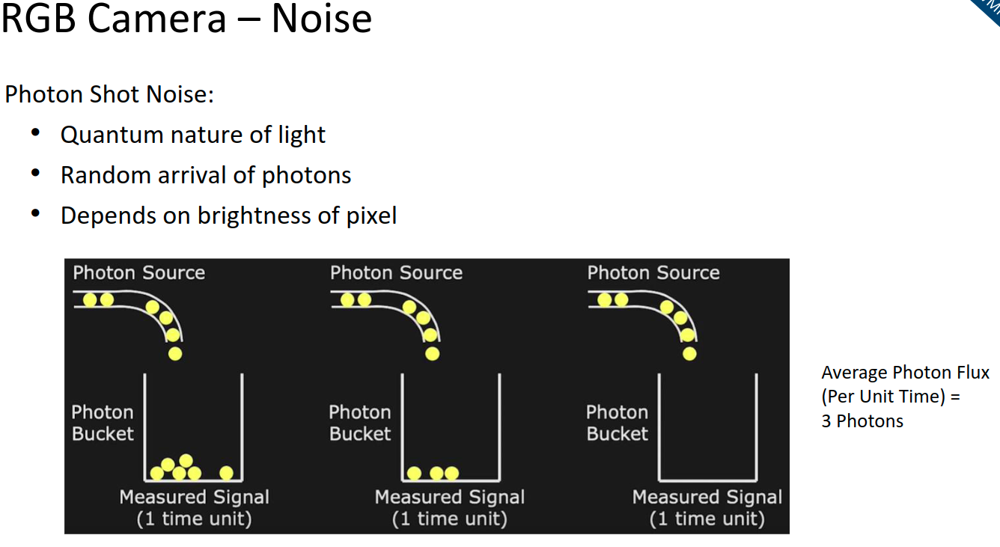

### Load Dataset

In [4]:
original_dataset = OriginalDataset('../datasets/droid_100_sample_pictures')
len_ = (original_dataset.__len__())
print(len_)

166


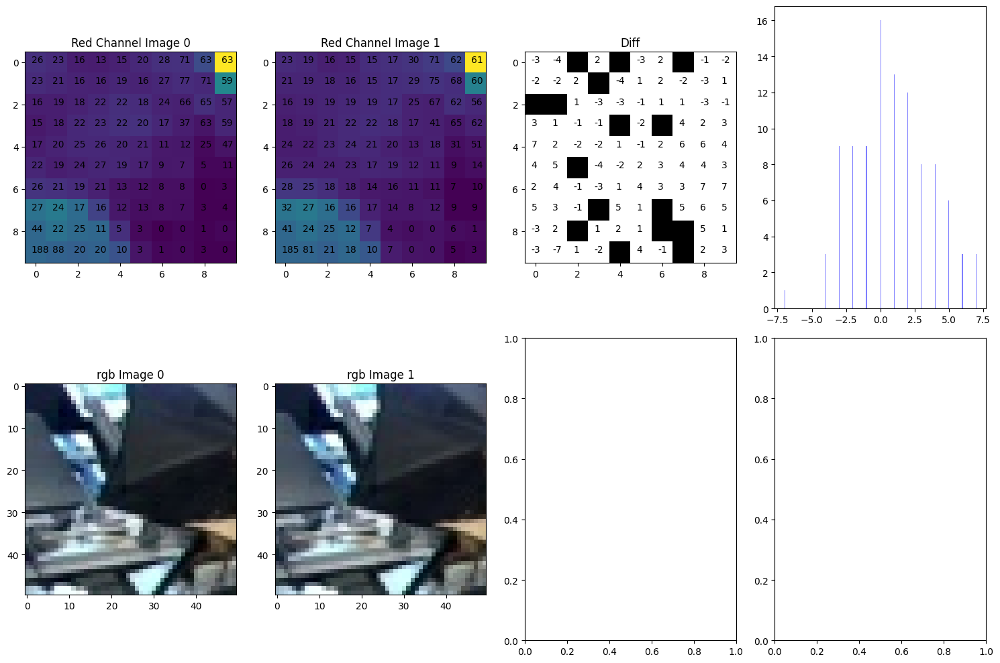

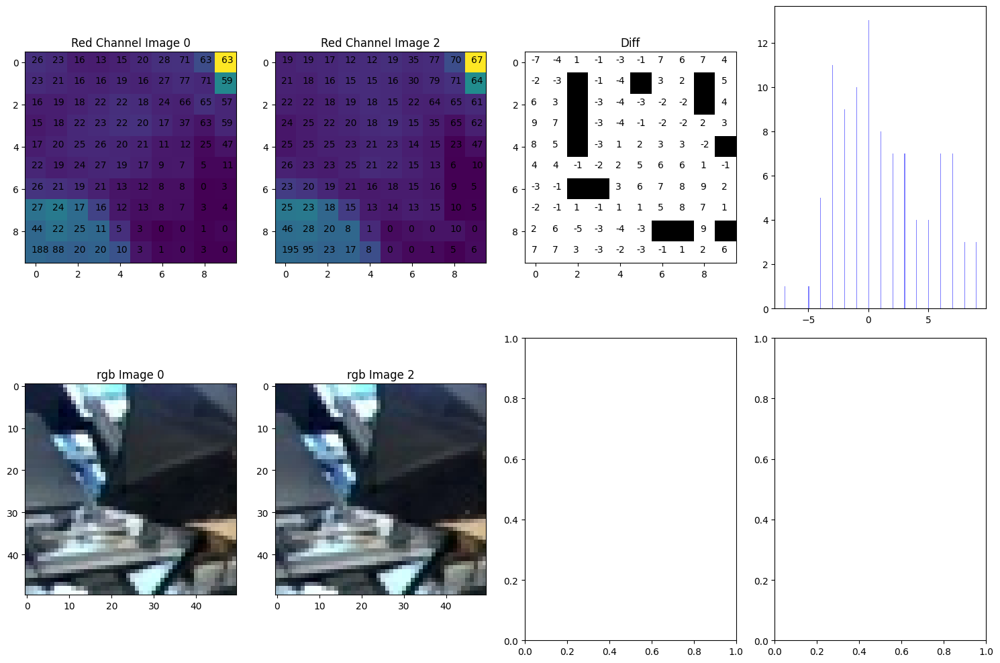

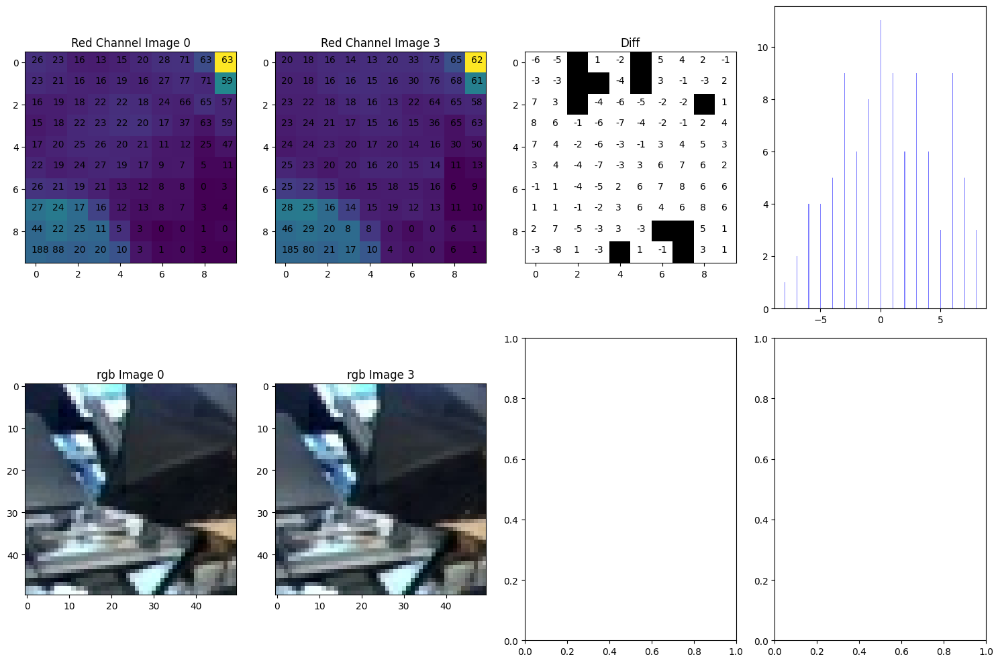

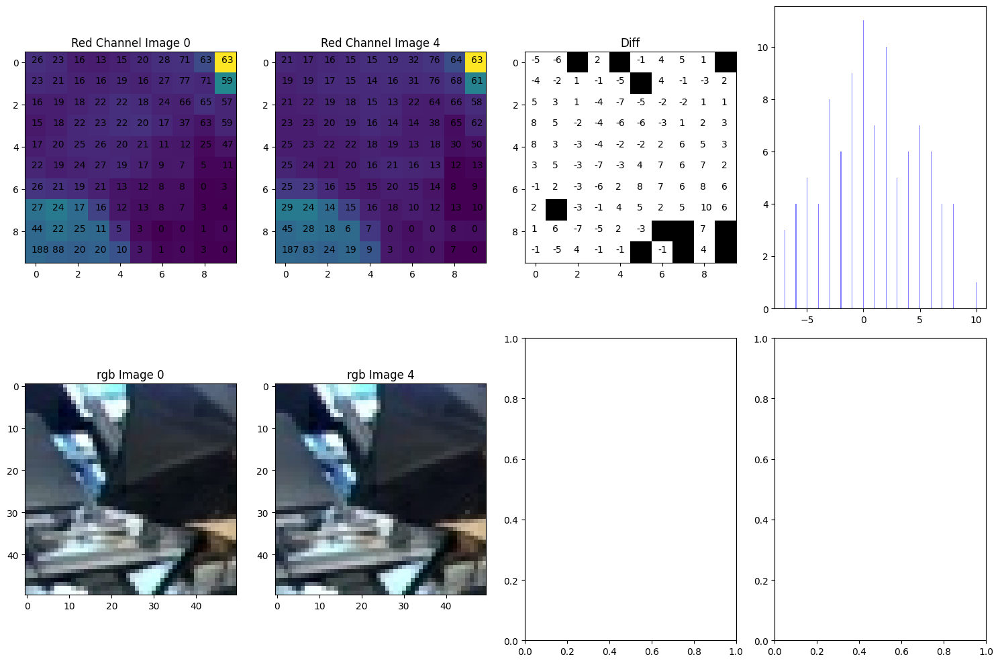

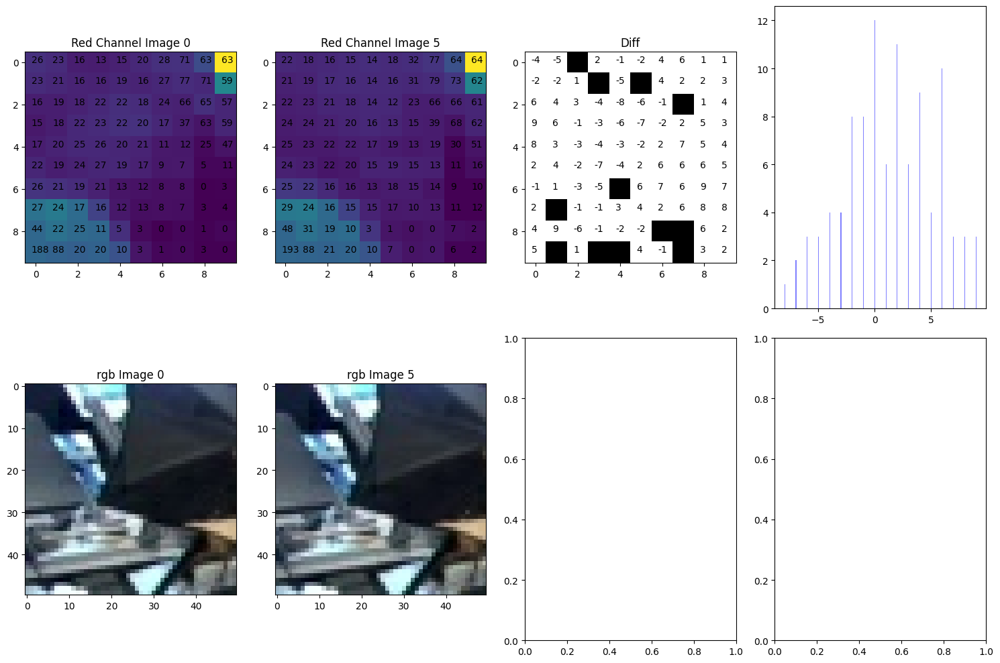

...

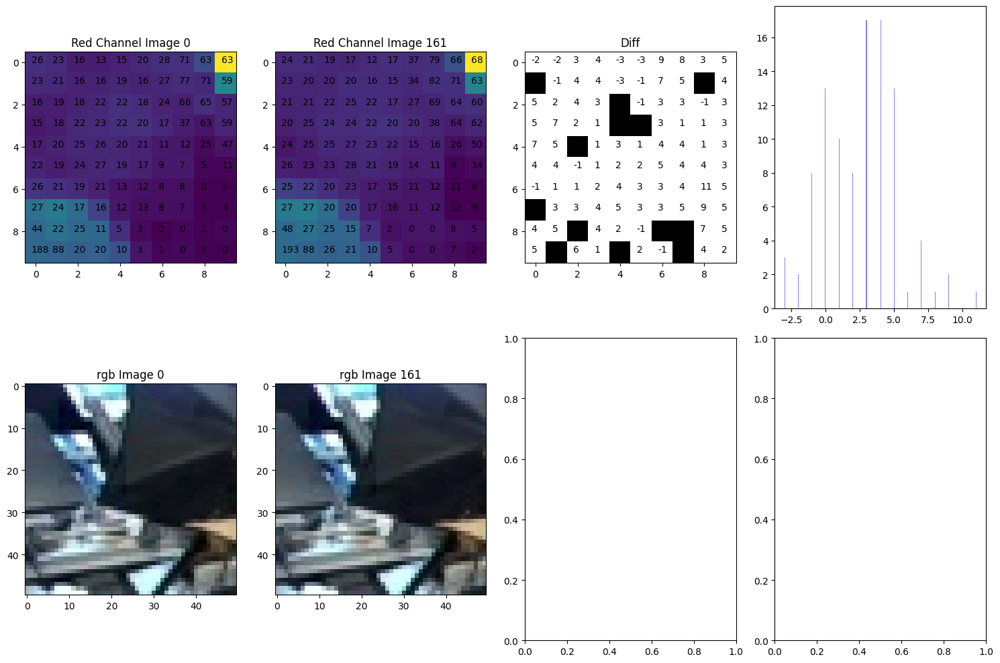

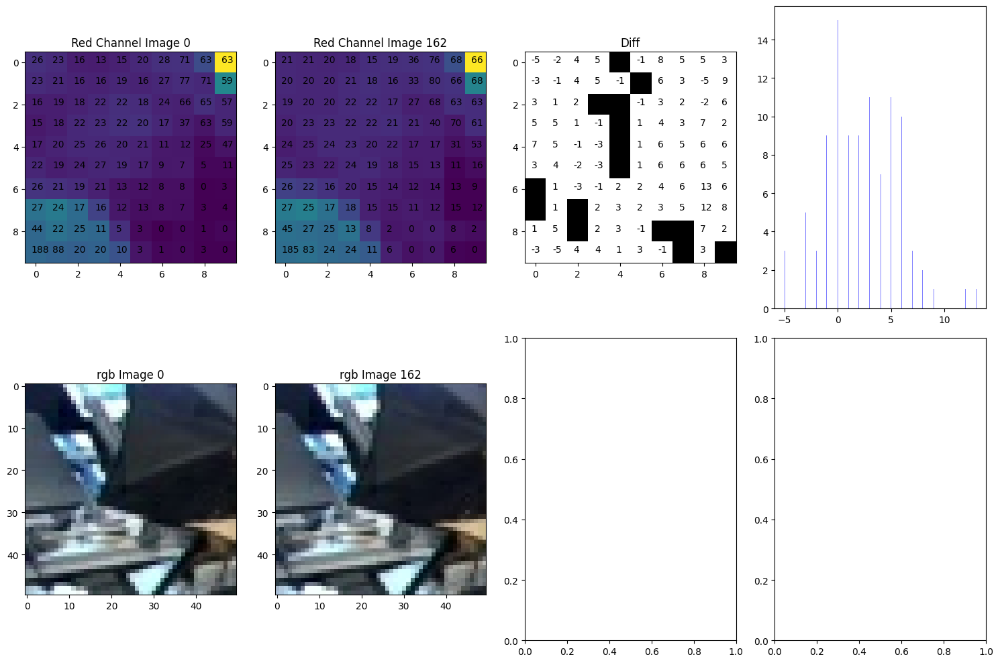

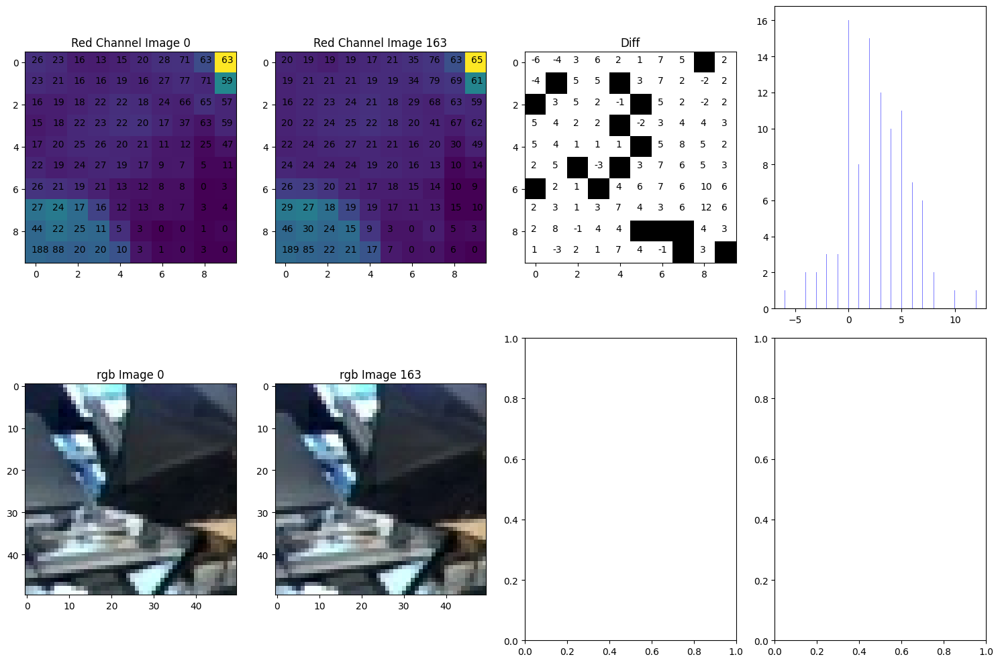

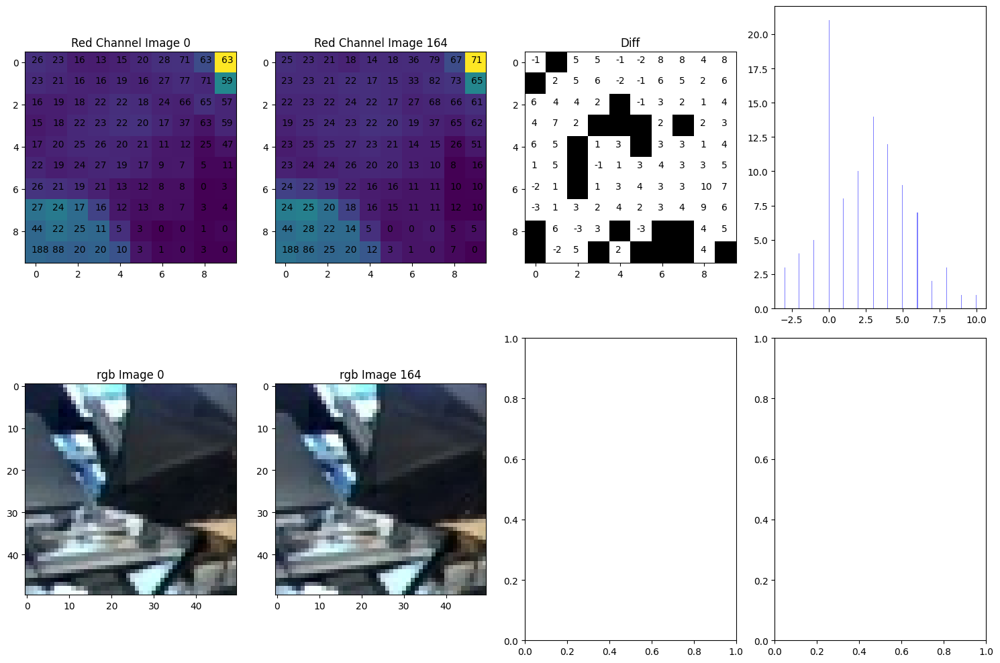

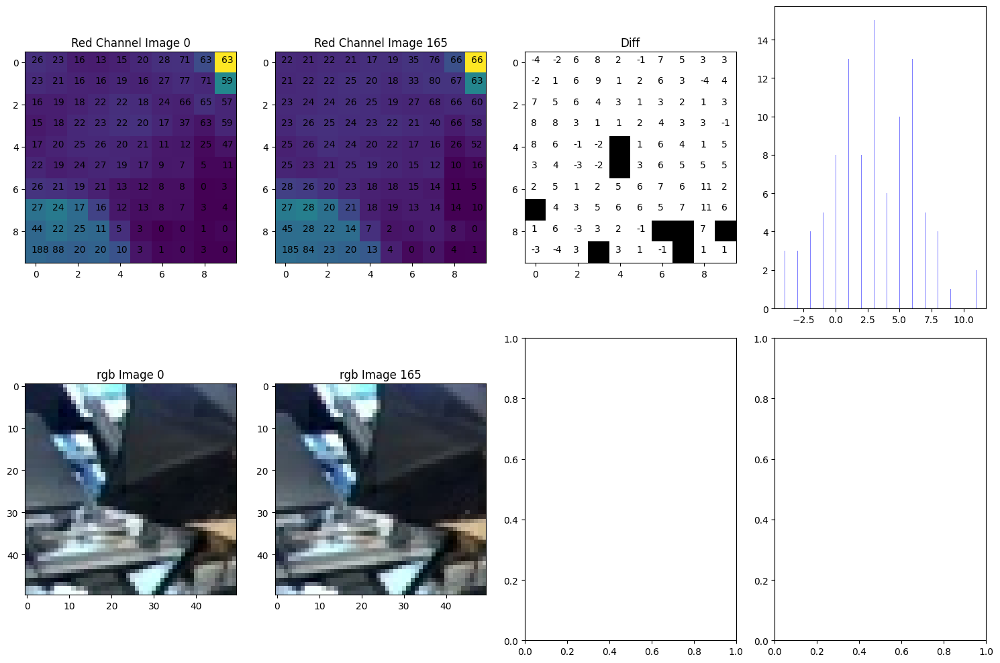

In [5]:
num_imgs = 166
roi = [0, 10, 0, 10]
rgb_image1 = original_dataset[0]
image1 = rgb_image1[roi[0]:roi[1], roi[2]:roi[3], :][:, :, 0]
image1 = np.array(image1, dtype = np.int16)

diff_array = []
for i in range(num_imgs):
    if i== 0:
        continue
    rgb_image2 = original_dataset[i]
    image2 = rgb_image2[roi[0]:roi[1], roi[2]:roi[3], :][:, :, 0]
    image2 = np.array(image2, dtype = np.int16)
    diff_img = image2 - image1
    non_zero_diff_count, image3 = plot_delta(diff_img, color=False)
    image3*=255
    # Create a figure to hold the subplots
    fig, axes = plt.subplots(2, 4, figsize=(15, 10))
#     print(image1.shape)
    # Plot each image
    axes[0][0].imshow(image1)
    axes[0][0].set_title('Red Channel Image 0')
    # note that a larger region in image is shown so that it looks visually meaningful
    axes[1][0].imshow(rgb_image1[roi[0]:50, roi[2]:50, :])
    axes[1][0].set_title('rgb Image 0')
    for o in range(image3.shape[0]):
        for p in range(image3.shape[1]):
            axes[0][0].text(o-0.2,p, f"{image1[o][p]}")
    axes[0][1].imshow(image2)
    axes[1][1].imshow(rgb_image2[roi[0]:50, roi[2]:50, :])
    axes[1][1].set_title(f'rgb Image {i}')
    for m in range(image3.shape[0]):
        for n in range(image3.shape[1]):
            axes[0][1].text(m-0.2,n, f"{image2[m][n]}")
    axes[0][1].set_title(f'Red Channel Image {i}')
    
    axes[0][2].imshow(image3, cmap="gray")
    axes[0][2].set_title('Diff')
    for q in range(image3.shape[0]):
        for r in range(image3.shape[1]):
            axes[0][2].text(q-0.2,r, f"{diff_img[q][r]}")
    # plot for all channels
    axes[0][3].hist(diff_img.ravel(), bins=256, color='b', alpha=0.5)
    plt.tight_layout()
    plt.show()
    
    r = 0
    c = 4
    diff_array.append(diff_img.ravel())
diff_array = np.array(diff_array)
#     print("image2[r][c]: ", image2[r][c], "image2[r][c]: ", image1[r][c])
#     print(f"diff_image[r][c]: ", diff_img[r][c])
#     print(image3)

## diff array
this array contains the diff of the images with respect to the first image (currently only a small region in the image is considered)

(image found online, not from our dataset)<img src="attachment:image.png" width="400">

In [6]:
print(diff_array.shape)

(165, 100)


In [18]:
# ** the function below is burrowed from chatgpt for quick testing
# Function to find most common vector using K-Means
def most_common_vector_kmeans(data, n_clusters=10):
    # Initialize and fit K-Means model
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    labels = kmeans.fit_predict(data)
    
    # Count occurrences of each cluster label
    label_counts = Counter(labels)
    most_common_label = label_counts.most_common(1)[0][0]
    
    # Get the centroid of the most common cluster as the representative vector
    most_common_vector = kmeans.cluster_centers_[most_common_label]
    
    return most_common_vector, most_common_label, kmeans

In [41]:
most_common_vector, most_common_label, kmeans = most_common_vector_kmeans(diff_array, n_clusters=2)

In [42]:
most_common_label

0

In [43]:
np.array(list(map(int, list(most_common_vector))))

array([-7, -4,  3,  5,  6,  2,  0, -1,  0,  1, -5, -3,  0,  4,  4,  4,  1,
        0,  4, -3,  2,  2,  3,  1,  0, -1,  0,  2, -3,  4,  3,  2,  0,  0,
       -2, -2,  0,  1,  2,  0,  0, -1, -1,  0,  1,  0,  4,  4,  2,  2, -1,
        0, -1,  0,  0,  2,  4,  3,  0,  1,  7,  4,  1,  1,  5,  7,  6,  3,
        0,  0,  4,  2,  1,  2,  6,  6,  6,  5,  0,  0,  3, -2,  1,  3,  4,
        7, 10,  9,  6,  1,  3,  3,  4,  2,  4,  4,  5,  5,  1,  1])

In [44]:
np.sum(kmeans.labels_)

64

In [45]:
from sklearn.metrics import pairwise_distances

# Get the distances between each data point and its assigned cluster center
distances = pairwise_distances(diff_array, kmeans.cluster_centers_)
print("Distances between each vector and its cluster center:", distances)

Distances between each vector and its cluster center: [[25.44596448 26.32735997]
 [28.49252254 37.89259338]
 [25.66833545 30.36813516]
 [25.1254689  30.21390214]
 [24.92785787 31.81153302]
 [27.50557242 36.67303005]
 [26.27335508 35.99963379]
 [29.21806167 31.94485299]
 [25.24399898 32.1160767 ]
 [26.79352809 37.33679329]
 [31.38915874 41.57641919]
 [24.25344886 29.28478501]
 [21.06101648 31.05748513]
 [20.19906084 27.70500646]
 [37.21401949 29.01408938]
 [23.98229708 27.77372648]
 [40.37095416 33.7324752 ]
 [24.26120399 30.4282744 ]
 [29.53353655 37.02075273]
 [30.41563692 34.16556941]
 [29.89870819 38.55521862]
 [27.82071454 37.76951327]
 [21.07276594 27.0214939 ]
 [17.6694646  23.28703787]
 [25.5844956  22.25010973]
 [22.66549869 33.18092272]
 [19.31197954 27.70557043]
 [19.14644137 22.75903409]
 [25.47396417 24.00921454]
 [18.27084675 24.53960845]
 [20.0534454  23.0550674 ]
 [17.21794135 20.7252535 ]
 [16.75366309 20.29790341]
 [17.15457042 26.51659637]
 [23.25774819 22.75903409]
 

# a tiny nn (code taken from chatgpt)

In [90]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau
from torch.utils.data import DataLoader, TensorDataset

# Generate or input your integer data here; let's assume values are in the range [0, 1000].
np.random.seed(0)
torch.manual_seed(0)

num_samples, vector_dim = diff_array.shape

# Create a random dataset of integer vectors with values in the range [0, 1000]
data = diff_array.astype(np.float32)

# Assign each vector a position; in this case, let's use a sequential index as the position.
positions = np.arange(num_samples).reshape(-1, 1).astype(np.float32)

# Min-Max normalization of vectors to range [0, 1]
data_min = data.min(axis=0)
data_max = data.max(axis=0)
# data_normalized = (data - data_min) / (data_max - data_min)

data_range = data_max - data_min
data_range[data_range == 0] = 1  # Set zero range to 1 to avoid division by zero
data_normalized = (data - data_min) / data_range

print("Any NaN in data:", np.isnan(data_normalized).any())
print("Any Inf in data:", np.isinf(data_normalized).any())

# Convert data to PyTorch tensors
positions_tensor = torch.tensor(positions)
data_tensor = torch.tensor(data_normalized)

# Create a DataLoader for easy batching
dataset = TensorDataset(positions_tensor, data_tensor)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

# Define the neural network model
class TinyNN(nn.Module):
    def __init__(self, vector_dim):
        super(TinyNN, self).__init__()
        self.fc1 = nn.Linear(1, 128)  # More complex
        self.fc2 = nn.Linear(128, 512)
        self.fc3 = nn.Linear(512,1024)
        self.fc4 = nn.Linear(1024,2048)
        self.fc5 = nn.Linear(2048, 4096)
        self.fc6 = nn.Linear(4096, 2048)
        self.fc7 = nn.Linear(2048,1024)
        self.fc8 = nn.Linear(1024,512)
        self.fc9 = nn.Linear(512, 128)
        self.fc10 = nn.Linear(128, vector_dim)
        
    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = torch.relu(self.fc3(x))

        x = torch.relu(self.fc4(x))
        x = torch.relu(self.fc5(x))
        x = torch.relu(self.fc6(x))

        x = torch.relu(self.fc7(x))
        x = torch.relu(self.fc8(x))
        x = torch.relu(self.fc9(x))

        x = self.fc10(x)
        return x

# Initialize the model, loss function, and optimizer
model = TinyNN(vector_dim=vector_dim)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=10, gamma=0.1) 
# scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=5, verbose=True)
min_delta = 0.001
epochs_no_improve = 0 
patience = 20

# Training loop
best_loss = float('inf') 
epochs = 100
for epoch in range(epochs):
    model.train()
    epoch_loss = 0.0
    for positions_batch, vectors_batch in dataloader:
        # Forward pass
        predictions = model(positions_batch)
        # print(f"{predictions.shape = }")
        # print(f"{vectors_batch.shape = }")
        
        loss = criterion(predictions[0], vectors_batch[0])
        
        # print(f"{loss.item() = }")
        # assert False
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        epoch_loss += loss.item()

    # scheduler.step()
    # Print the average loss for each epoch
    avg_loss = epoch_loss / len(dataloader)
    # scheduler.step(avg_loss)

    if avg_loss < best_loss:
        best_loss = avg_loss

    # if avg_loss < best_loss-min_delta :
    #     best_loss = avg_loss
    #     epochs_no_improve = 0  # Reset the counter if loss improved
    #     print(f"Loss improved to {best_loss:.4f}, resetting patience counter.")
    # else:
    #     epochs_no_improve += 1
    #     print(f"Epochs without improvement: {epochs_no_improve}/{patience}")

    # If no improvement for 'patience' epochs, stop training
    # if epochs_no_improve >= patience:
    #     print(f"Early stopping triggered after {epoch+1} epochs.")
    #     break
    
   
    print(f"Epoch [{epoch+1}/{epochs}], Avg Loss: {avg_loss:.4f}")
    print(f"Epoch [{epoch+1}/{epochs}], Best Loss: {best_loss:.4f}")




Any NaN in data: False
Any Inf in data: False
Epoch [1/100], Avg Loss: 0.2145
Epoch [1/100], Best Loss: 0.2145
Epoch [2/100], Avg Loss: 0.0698
Epoch [2/100], Best Loss: 0.0698
Epoch [3/100], Avg Loss: 0.0397
Epoch [3/100], Best Loss: 0.0397
Epoch [4/100], Avg Loss: 0.0393
Epoch [4/100], Best Loss: 0.0393
Epoch [5/100], Avg Loss: 0.0394
Epoch [5/100], Best Loss: 0.0393
Epoch [6/100], Avg Loss: 0.0391
Epoch [6/100], Best Loss: 0.0391
Epoch [7/100], Avg Loss: 0.0396
Epoch [7/100], Best Loss: 0.0391
Epoch [8/100], Avg Loss: 0.0385
Epoch [8/100], Best Loss: 0.0385
Epoch [9/100], Avg Loss: 0.0391
Epoch [9/100], Best Loss: 0.0385
Epoch [10/100], Avg Loss: 0.0383
Epoch [10/100], Best Loss: 0.0383
Epoch [11/100], Avg Loss: 0.0385
Epoch [11/100], Best Loss: 0.0383
Epoch [12/100], Avg Loss: 0.0381
Epoch [12/100], Best Loss: 0.0381
Epoch [13/100], Avg Loss: 0.0377
Epoch [13/100], Best Loss: 0.0377
Epoch [14/100], Avg Loss: 0.0375
Epoch [14/100], Best Loss: 0.0375
Epoch [15/100], Avg Loss: 0.0374
E

In [91]:
# Test the model by predicting a vector for a given position
model.eval()
print(model)
test_position = torch.tensor([[4]], dtype=torch.float32)  # Example position
with torch.no_grad():
    predicted_vector_normalized = model(test_position).numpy()

# Reverse the normalization to get back to the original integer range
predicted_vector = predicted_vector_normalized * (data_max - data_min) + data_min
predicted_vector_int = np.round(predicted_vector).astype(int)  # Convert to integer

print("Predicted vector at position 500 (original integer domain):", predicted_vector_int)
print(f'min = {min(predicted_vector_int[0])}')
print(f'max = {max(predicted_vector_int[0])}')
print(f'len = {len(predicted_vector_int[0])}')
print(f'zero count = {len(predicted_vector_int[0])- np.count_nonzero(predicted_vector_int[0])}')

TinyNN(
  (fc1): Linear(in_features=1, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=1024, bias=True)
  (fc4): Linear(in_features=1024, out_features=2048, bias=True)
  (fc5): Linear(in_features=2048, out_features=4096, bias=True)
  (fc6): Linear(in_features=4096, out_features=2048, bias=True)
  (fc7): Linear(in_features=2048, out_features=1024, bias=True)
  (fc8): Linear(in_features=1024, out_features=512, bias=True)
  (fc9): Linear(in_features=512, out_features=128, bias=True)
  (fc10): Linear(in_features=128, out_features=100, bias=True)
)
Predicted vector at position 500 (original integer domain): [[-6 -3  5  7  7  3 -2  0  1  1 -5 -3  2  5  3  4  0  0  6 -3  1  1  1 -1
  -2 -2 -2  0 -5  3  1  0 -3 -4 -4 -6 -4 -1 -2 -2 -1 -4 -5 -4 -1 -1  2  3
   1 -1 -1  0 -4 -4 -1  3  6  4 -2  1  5  3 -1 -1  3  6  7  3  0 -1  5  0
  -1  0  5  6  7  6  0  0  2 -2  0  2  3  5  8  8  6  3  1  3  2  3  2  2
   5 

In [92]:
def get_model_prediction(model, position: int):
    model.eval()
    test_position = torch.tensor([[position]], dtype=torch.float32)  # Example position
    with torch.no_grad():
        predicted_vector_normalized = model(test_position).numpy()

    # Reverse the normalization to get back to the original integer range
    predicted_vector = predicted_vector_normalized * (data_max - data_min) + data_min
    predicted_vector_int = np.round(predicted_vector).astype(int)  # Convert to integer

#     print("Predicted vector at position 500 (original integer domain):", predicted_vector_int)
    return predicted_vector_int[0]


Text(0.5, 1.0, '% of zeros in delta - NN fitted on entire data')

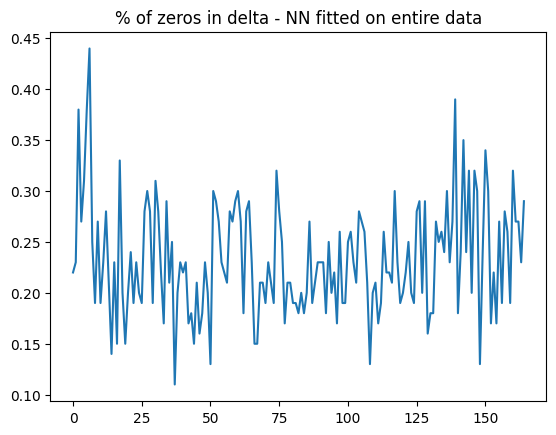

In [93]:
data = diff_array
# sns.distplot(data)
# plt.show()
# Fit a normal distribution to the data:
# mu, std = norm.fit(data)
# print(mu, std)
num_zeros =[]
for i in range(len(diff_array)):
    predicted_delta = get_model_prediction(model, position=i)
    delta = predicted_delta - diff_array[i]
#     print(delta)
    zero_count = np.sum(delta == 0)  / len(delta)
    num_zeros.append(zero_count)
plt.plot(num_zeros)
plt.title("% of zeros in delta - NN fitted on entire data")

** CNN based approach **

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np

# Modify the CNN for overfitting (increase complexity, no regularization)
class OverfittingCNN(nn.Module):
    def __init__(self, num_classes=10):
        super(OverfittingCNN, self).__init__()

        # Increase the complexity (more filters, more layers)
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        
        # Fully connected layers
        self.fc1 = nn.Linear(256 * 8 * 8, 1024)  # Increased output size
        self.fc2 = nn.Linear(1024, num_classes)
        
    def forward(self, x):
        x = self.pool(torch.relu(self.conv1(x)))
        x = self.pool(torch.relu(self.conv2(x)))
        x = self.pool(torch.relu(self.conv3(x)))
        
        x = x.view(-1, 256 * 8 * 8)  # Flattening
        
        x = torch.relu(self.fc1(x))  # Fully connected layer
        x = self.fc2(x)  # Output layer
        
        return x

# Create a very small dataset for overfitting
# Let's create a random small dataset (e.g., 10 images, 3 channels, 32x32)
X = torch.randn(10, 3, 32, 32)  # 10 images, 3 channels, 32x32 pixels
y = torch.randint(0, 10, (10,))  # 10 random labels, 0 to 9 (for 10 classes)

# Create a DataLoader for batching
dataset = TensorDataset(X, y)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

# Initialize the model, optimizer, and loss function
model = OverfittingCNN(num_classes=10)
optimizer = optim.Adam(model.parameters(), lr=0.0001)  # Small learning rate to encourage overfitting
criterion = nn.CrossEntropyLoss()

# Training loop for overfitting
epochs = 1000  # High number of epochs to encourage overfitting
for epoch in range(epochs):
    model.train()
    epoch_loss = 0.0
    correct = 0
    total = 0

    for inputs, labels in dataloader:
        # Forward pass
        outputs = model(inputs)
        
        # Calculate loss
        loss = criterion(outputs, labels)
        
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

        # Calculate accuracy
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    avg_loss = epoch_loss / len(dataloader)
    accuracy = 100 * correct / total
    
    print(f"Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")

    # Check if the model perfectly overfits (accuracy of 100%)
    if accuracy == 100:
        print(f"Model overfitted on the training data at epoch {epoch+1}")
        break
